<a href="https://colab.research.google.com/github/oliviabruvik/CS231N_final_project/blob/main/finalProjectWithInceptionAndDropout.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# CS 231N Final Project: Coding Prototype
Based on paper: https://arxiv.org/abs/1611.07004

Implementing Unet with GAN


## System Set-**up**

In [40]:
import torch
print(torch.cuda.is_available())

True


In [41]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torch.utils.data import sampler

import torchvision.datasets as dset
import torchvision.transforms as T

import numpy as np

USE_GPU = True
dtype = torch.float32 # We will be using float throughout this tutorial.

if USE_GPU and torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')

# Constant to control how frequently we print train loss.
print_every = 100
print('using device:', device)

using device: cuda


In [42]:
## Fastai
import os
import glob
import time
import numpy as np
from PIL import Image
from pathlib import Path
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
from skimage.color import rgb2lab, lab2rgb

import torch
from torch import nn, optim
from torchvision import transforms
from torchvision.utils import make_grid
from torch.utils.data import Dataset, DataLoader
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
use_colab = None

In [43]:
# !pip install fastai==2.4

## Load data

In [44]:
from fastai.data.external import untar_data, URLs
coco_path = untar_data(URLs.COCO_SAMPLE)
coco_path = str(coco_path) + "/train_sample"
use_colab = True

In [45]:
if use_colab == True:
    path = coco_path
else:
    path = "Your path to the dataset"

paths = glob.glob(path + "/*.jpg") # Grabbing all the image file names
np.random.seed(123)
paths_subset = np.random.choice(paths, 10_000, replace=False) # choosing 1000 images randomly
rand_idxs = np.random.permutation(10_000)
train_idxs = rand_idxs[:8000] # choosing the first 8000 as training set
val_idxs = rand_idxs[8000:] # choosing last 2000 as validation set
#train_idxs = rand_idxs[:4000] # choosing the first 4000 as training set
#val_idxs = rand_idxs[4000:5000] # choosing 1000 as validation set
train_paths = paths_subset[train_idxs]
val_paths = paths_subset[val_idxs]
print(len(train_paths), len(val_paths))

8000 2000


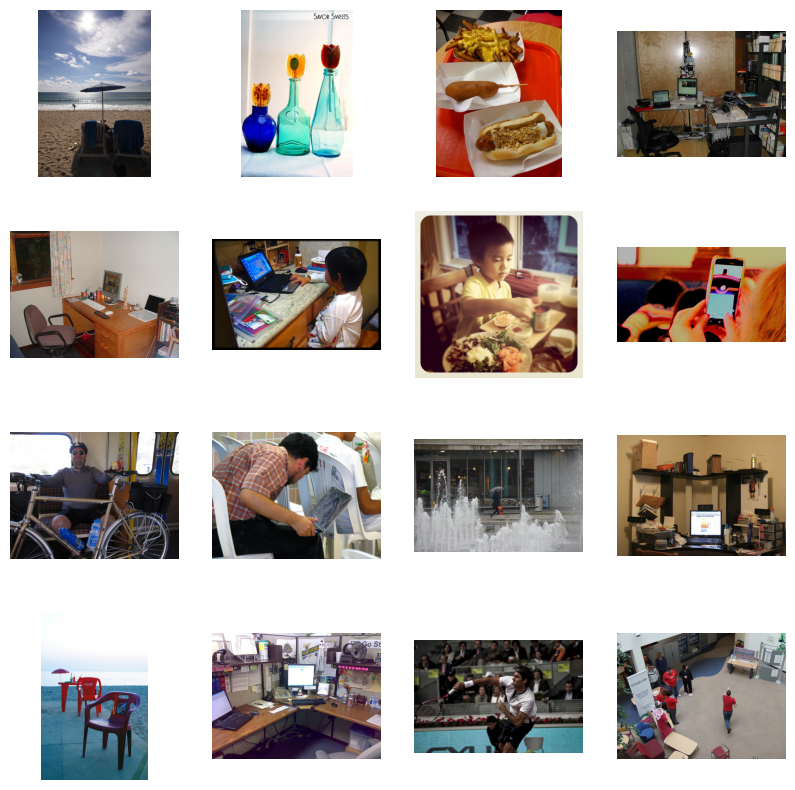

In [46]:
_, axes = plt.subplots(4, 4, figsize=(10, 10))
for ax, img_path in zip(axes.flatten(), train_paths):
    ax.imshow(Image.open(img_path))
    ax.axis("off")

## 1.2- Making Datasets and DataLoaders

In [47]:
SIZE = 256
SIZE_INC = 299
class ColorizationDataset(Dataset):
    def __init__(self, paths, split='train'):
        if split == 'train':
            self.transforms = transforms.Compose([
                transforms.Resize((SIZE, SIZE),  Image.BICUBIC),
                transforms.RandomHorizontalFlip(), # A little data augmentation!
            ])
        elif split == 'val':
            self.transforms = transforms.Resize((SIZE, SIZE),  Image.BICUBIC)

        self.split = split
        self.size = SIZE
        self.paths = paths

    def __getitem__(self, idx):
        img = Image.open(self.paths[idx]).convert("RGB")
        img = self.transforms(img)
        img_inc = transforms.Resize((SIZE_INC, SIZE_INC), Image.BICUBIC)(img)

        img = np.array(img)
        img_inc = np.array(img_inc)
        img_rgb = transforms.ToTensor()(img)

        img_lab = rgb2lab(img).astype("float32") # Converting RGB to L*a*b
        img_lab_inc = rgb2lab(img_inc).astype("float32")

        img_lab = transforms.ToTensor()(img_lab)
        img_lab_inc = transforms.ToTensor()(img_lab_inc)

        L = img_lab[[0], ...] / 50. - 1. # Between -1 and 1
        ab = img_lab[[1, 2], ...] / 110. # Between -1 and 1

        L_inc = img_lab_inc[[0], ...] / 50. - 1. # Between -1 and 1
        ab_inc = img_lab[[1, 2], ...] / 110. # Between -1 and 1

        return {'L': L, 'ab': ab, "L_inc": L_inc, "L_enc": L, "RGB": img_rgb}

    def __len__(self):
        return len(self.paths)

def make_dataloaders(batch_size=16, n_workers=4, pin_memory=True, **kwargs): # A handy function to make our dataloaders
    dataset = ColorizationDataset(**kwargs)
    dataloader = DataLoader(dataset, batch_size=batch_size, num_workers=n_workers,
                            pin_memory=pin_memory)
    return dataloader

In [48]:
train_dl = make_dataloaders(paths=train_paths, batch_size=16, split='train')
val_dl = make_dataloaders(paths=val_paths, batch_size=16, split='val')

data = next(iter(train_dl))
Ls, abs_, L_inc, rgb_img = data['L'], data['ab'], data["L_inc"], data["RGB"]
print(Ls.shape, abs_.shape, L_inc.shape, rgb_img.shape)
print(len(train_dl), len(val_dl))

torch.Size([16, 1, 256, 256]) torch.Size([16, 2, 256, 256]) torch.Size([16, 1, 299, 299]) torch.Size([16, 3, 256, 256])
500 125


## 1.3- Generator proposed by the paper

In [67]:
class ImgEncoder(nn.Module):

    def __init__(self):
        super(ImgEncoder, self).__init__()

        self.layers = nn.Sequential(
            # Conv1
            nn.Conv2d(24, 3, 3, stride=1, padding=1),

            #nn.Conv2d(3, 64, 3, stride=2, padding=2),
            nn.Conv2d(3, 64, 3, stride=2, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),

            # Conv2
            nn.Conv2d(64, 128, 3, stride=1, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(128),

            # randomness
            # nn.Dropout(p=0.2),

            # Conv3
            nn.Conv2d(128, 128, 3, stride=2, padding=1),
            #nn.Conv2d(128, 128, 3, stride=2, padding=2),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(128),

            # Conv4
            nn.Conv2d(128, 256, 3, stride=1, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(256),

            # Conv5
            nn.Conv2d(256, 256, 3, stride=2, padding=1),
            #nn.Conv2d(256, 256, 3, stride=2, padding=2),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(256),

            # randomness
            # nn.Dropout(p=0.2),

            # Conv6
            nn.Conv2d(256, 512, 3, stride=1, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(512),

            # Conv7
            nn.Conv2d(512, 512, 3, stride=1, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(512),

            # Conv8
            nn.Conv2d(512, 256, 3, stride=1, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(256),
        )

    def forward(self, x):
        return self.layers(x)

In [50]:
import torchvision.models as models

#inception = models.inception_v3(pretrained=True)
#inception = models.segmentation.deeplabv3_resnet50(weights = 'DeepLabV3_ResNet50_Weights.COCO_WITH_VOC_LABELS_V1')

In [51]:
class ImgFusion(nn.Module):

    def __init__(self):
        super(ImgFusion, self).__init__()
        # In practice nothing here

    def forward(self, img1, img2):

        # print(shape)
        img2 = torch.stack([torch.stack([img2],dim=2)],dim=3)
        img2 = img2.repeat(1, 1, img1.shape[2], img1.shape[3])
        # print(img1.shape)
        # print(img2.shape)
        return torch.cat((img1, img2),1)

In [52]:
class ImgDecoder(nn.Module):

    def __init__(self):
        super(ImgDecoder, self).__init__()

        self.layers = nn.Sequential(

            # Conv1
            nn.Conv2d(256, 128, 3, stride=1, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(128),

            # Upsample1
            nn.Upsample(scale_factor=2.0),

            # Conv2
            nn.Conv2d(128, 64, 3, stride=1, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),

            # randomness
            # nn.Dropout(p=0.2),

            # Conv3
            nn.Conv2d(64, 64, 3, stride=1, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(64),

            # randomness
            # nn.Dropout(p=0.2),

            # Upsample2
            nn.Upsample(scale_factor=2.0),

            # Conv4
            nn.Conv2d(64, 32, 3, stride=1, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(32),

            # randomness
            # nn.Dropout(p=0.2),

            # Conv5
            nn.Conv2d(32, 2, 3, stride=1, padding=1),
            nn.Tanh(),

            # Upsample3
            nn.Upsample(scale_factor=2.0),
        )

    def forward(self, x):
        return self.layers(x)

In [53]:
class ColorNet(nn.Module):

    def __init__(self):
        super(ColorNet, self).__init__()
        self.encoder = ImgEncoder()
        self.fusion = ImgFusion()
        # self.decoder = ImgDecoder(256)
        self.decoder = ImgDecoder()
        self.post_fuse = nn.Conv2d(1256, 256, 1, stride=1, padding=0)
        self.relu = nn.ReLU(inplace=True)

    def forward(self, img1, img2):

        # Encoder Output
        out_enc = self.encoder(img1)

        # Fusion
        temp = self.fusion(out_enc, img2)
        temp = self.post_fuse(temp)
        temp = self.relu(temp)

        # Decoder Output
        temp = self.decoder(temp)
        #temp2 = self.encoder(img1)
        #print("temp", temp.shape)

        #temp2 = self.decoder(temp2)
        #print("temp2", temp.shape)
        return temp

## Inception

## Discriminator


In [72]:
class PatchDiscriminator(nn.Module):
    def __init__(self, input_c, num_filters=64, n_down=3):
        super().__init__()
        model = [self.get_layers(input_c, num_filters, norm=False)]
        model += [self.get_layers(num_filters * 2 ** i, num_filters * 2 ** (i + 1), s=1 if i == (n_down-1) else 2)
                          for i in range(n_down)] # the 'if' statement is taking care of not using
                                                  # stride of 2 for the last block in this loop
        model += [self.get_layers(num_filters * 2 ** n_down, 1, s=1, norm=False, act=False)] # Make sure to not use normalization or
                                                                                             # activation for the last layer of the model
        self.model = nn.Sequential(*model)

    def get_layers(self, ni, nf, k=4, s=2, p=1, norm=True, act=True): # when needing to make some repeatitive blocks of layers,
        layers = [nn.Conv2d(ni, nf, k, s, p, bias=not norm)]          # it's always helpful to make a separate method for that purpose
        if norm: layers += [nn.BatchNorm2d(nf)]
        if act: layers += [nn.LeakyReLU(0.2, True)]
        # randomness
        # layers += [nn.Dropout(p=0.2)]
        return nn.Sequential(*layers)

    def forward(self, x):
        return self.model(x)

In [73]:
PatchDiscriminator(3)

PatchDiscriminator(
  (model): Sequential(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (2): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (3): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (

In [74]:
discriminator = PatchDiscriminator(3)
dummy_input = torch.randn(16, 3, 256, 256) # batch_size, channels, size, size
out = discriminator(dummy_input)
out.shape

torch.Size([16, 1, 30, 30])

## Gan loss

In [57]:
class GANLoss(nn.Module):
    def __init__(self, gan_mode='vanilla', real_label=1.0, fake_label=0.0):
        super().__init__()
        self.register_buffer('real_label', torch.tensor(real_label))
        self.register_buffer('fake_label', torch.tensor(fake_label))
        if gan_mode == 'vanilla':
            self.loss = nn.BCEWithLogitsLoss()
        elif gan_mode == 'lsgan':
            self.loss = nn.MSELoss()

    def get_labels(self, preds, target_is_real):
        if target_is_real:
            labels = self.real_label
        else:
            labels = self.fake_label
        return labels.expand_as(preds)

    def __call__(self, preds, target_is_real):
        labels = self.get_labels(preds, target_is_real)
        loss = self.loss(preds, labels)
        return loss

## Model Init


In [58]:
def init_weights(net, init='norm', gain=0.02):

    def init_func(m):
        classname = m.__class__.__name__
        if hasattr(m, 'weight') and 'Conv' in classname:
            if init == 'norm':
                nn.init.normal_(m.weight.data, mean=0.0, std=gain)
            elif init == 'xavier':
                nn.init.xavier_normal_(m.weight.data, gain=gain)
            elif init == 'kaiming':
                nn.init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')

            if hasattr(m, 'bias') and m.bias is not None:
                nn.init.constant_(m.bias.data, 0.0)
        elif 'BatchNorm2d' in classname:
            nn.init.normal_(m.weight.data, 1., gain)
            nn.init.constant_(m.bias.data, 0.)

    net.apply(init_func)
    print(f"model initialized with {init} initialization")
    return net

def init_model(model, device):
    model = model.to(device)
    model = init_weights(model)
    return model

## Main model

In [59]:
class MainModel(nn.Module):
    def __init__(self, net_G=None, lr_G=2e-4, lr_D=2e-4,
                 beta1=0.5, beta2=0.999, lambda_L1=100.):
        super().__init__()

        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.lambda_L1 = lambda_L1

        if net_G is None:
            self.net_G = init_model(ColorNet(), self.device)
            #self.net_G = init_model(Unet2(input_c=1, output_c=2, n_down=8, num_filters=64), self.device)
        else:
            self.net_G = net_G.to(self.device)
        self.net_D = init_model(PatchDiscriminator(input_c=3, n_down=3, num_filters=64), self.device)
        self.GANcriterion = GANLoss(gan_mode='vanilla').to(self.device)
        self.L1criterion = nn.L1Loss()
        self.opt_G = optim.Adam(self.net_G.parameters(), lr=lr_G, betas=(beta1, beta2))
        self.opt_D = optim.Adam(self.net_D.parameters(), lr=lr_D, betas=(beta1, beta2))

    def set_requires_grad(self, model, requires_grad=True):
        for p in model.parameters():
            p.requires_grad = requires_grad

    def setup_input(self, data):
        self.L_enc = data['L'].repeat(1, 3, 1, 1).to(self.device)
        self.L = data['L'].to(self.device)
        self.ab = data['ab'].to(self.device)
        self.L_in = data['L_inc'].repeat(1, 3, 1, 1)
        inception.to(self.device)
        self.L_in = self.L_in.to(self.device)
        with torch.no_grad():
          self.out_incept = inception(self.L_in).logits
        self.out_incept = self.out_incept.to(self.device)

        inception_coco.to(self.device)
        with torch.no_grad():
          self.out_incept_coco = inception_coco(self.L_enc)["out"]
          self.L_enc_coco = torch.cat([self.L_enc, self.out_incept_coco], dim=1)
        self.L_enc_coco = self.L_enc_coco.to(device)

    def forward(self):
        # self.fake_color = self.net_G(self.L)
        # self.fake_color = self.net_G(self.combined_input)
        self.fake_color = self.net_G(self.L_enc_coco, self.out_incept)
        #self.fake_color = self.net_G(self.L_enc, self.out_incept)

    def backward_D(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image.detach())
        self.loss_D_fake = self.GANcriterion(fake_preds, False)
        real_image = torch.cat([self.L, self.ab], dim=1)
        real_preds = self.net_D(real_image)
        self.loss_D_real = self.GANcriterion(real_preds, True)
        self.loss_D = (self.loss_D_fake + self.loss_D_real) * 0.5
        self.loss_D.backward()

    def backward_G(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image)
        self.loss_G_GAN = self.GANcriterion(fake_preds, True)
        self.loss_G_L1 = self.L1criterion(self.fake_color, self.ab) * self.lambda_L1
        self.loss_G = self.loss_G_GAN + self.loss_G_L1
        self.loss_G.backward()

    def optimize(self, i):
        self.forward()

        if i % 2 == 0:
          self.net_D.train()
          self.set_requires_grad(self.net_D, True)
          self.opt_D.zero_grad()
          self.backward_D()
          self.opt_D.step()

        self.net_G.train()
        self.set_requires_grad(self.net_D, False)
        self.opt_G.zero_grad()
        self.backward_G()
        self.opt_G.step()

## Utility functions

In [60]:
class AverageMeter:
    def __init__(self):
        self.reset()

    def reset(self):
        self.count, self.avg, self.sum = [0.] * 3

    def update(self, val, count=1):
        self.count += count
        self.sum += count * val
        self.avg = self.sum / self.count

def create_loss_meters():
    loss_D_fake = AverageMeter()
    loss_D_real = AverageMeter()
    loss_D = AverageMeter()
    loss_G_GAN = AverageMeter()
    loss_G_L1 = AverageMeter()
    loss_G = AverageMeter()

    return {'loss_D_fake': loss_D_fake,
            'loss_D_real': loss_D_real,
            'loss_D': loss_D,
            'loss_G_GAN': loss_G_GAN,
            'loss_G_L1': loss_G_L1,
            'loss_G': loss_G}

def update_losses(model, loss_meter_dict, count):
    for loss_name, loss_meter in loss_meter_dict.items():
        loss = getattr(model, loss_name)
        loss_meter.update(loss.item(), count=count)

def lab_to_rgb(L, ab):
    """
    Takes a batch of images
    """

    L = (L + 1.) * 50.
    ab = ab * 110.
    Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()
    rgb_imgs = []
    for img in Lab:
        img_rgb = lab2rgb(img)
        rgb_imgs.append(img_rgb)
    return np.stack(rgb_imgs, axis=0)

def visualize(model, data, writer, global_step=None, save=True):
    model.net_G.eval()
    with torch.no_grad():
        model.setup_input(data)
        model.forward()
    model.net_G.train()
    fake_color = model.fake_color.detach()
    real_color = model.ab
    L = model.L
    fake_imgs = lab_to_rgb(L, fake_color)
    real_imgs = lab_to_rgb(L, real_color)
    fig = plt.figure(figsize=(15, 8))
    for i in range(5):
        ax = plt.subplot(3, 5, i + 1)
        ax.imshow(L[i][0].cpu(), cmap='gray')
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 5)
        ax.imshow(fake_imgs[i])
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 10)
        ax.imshow(real_imgs[i])
        ax.axis("off")
    plt.show()
    if save:
        fig.savefig(f"colorization_{time.time()}.png")

    # Log images to TensorBoard
    # Convert the images to a format that TensorBoard accepts
    #L_imgs = torch.cat([L[i][0].cpu().unsqueeze(0) for i in range(5)], dim=1)
    fake_imgs_tb = torch.cat([torch.from_numpy(fake_imgs[i]).permute(2, 0, 1).unsqueeze(0) for i in range(5)], dim=0)
    real_imgs_tb = torch.cat([torch.from_numpy(real_imgs[i]).permute(2, 0, 1).unsqueeze(0) for i in range(5)], dim=0)

    # Add the images to TensorBoard
    # writer.add_image('L_channel', L_imgs, global_step)
    writer.add_images('Fake_images', fake_imgs_tb, global_step)
    writer.add_images('Real_images', real_imgs_tb, global_step)
    writer.close()

    # Add the images to TensorBoard
    # writer.add_image('L_channel', L_imgs, global_step)
    # writer.add_images('Fake_images', fake_imgs_tb, global_step)
    # writer.add_images('Real_images', real_imgs_tb, global_step)

def log_results(loss_meter_dict):
    for loss_name, loss_meter in loss_meter_dict.items():
        print(f"{loss_name}: {loss_meter.avg:.5f}")

## Training function: With Pretraining

In [61]:
from torch.utils.tensorboard import SummaryWriter

In [69]:
def pretrain_generator(net_G, train_dl, opt, criterion, epochs, device):
    pretrain_results = []
    for e in range(epochs):
        loss_meter = AverageMeter()
        for data in tqdm(train_dl):

          # code from setup data function
          L_enc = data['L'].repeat(1, 3, 1, 1).to(device)
          L = data['L'].to(device)
          ab = data['ab'].to(device)
          L_in = data['L_inc'].repeat(1, 3, 1, 1).to(device)
          inception.to(device)
          with torch.no_grad():
            out_incept = inception(L_in).logits
            out_incept = out_incept.to(device)

          with torch.no_grad():
            out_incept_coco = inception_coco(L_enc)["out"]
            L_enc_coco = torch.cat([L_enc, out_incept_coco], dim=1)
            L_enc_coco = L_enc_coco.to(device)

          preds = net_G(L_enc_coco, out_incept)
          loss = criterion(preds, ab)

          opt.zero_grad()
          loss.backward()
          opt.step()

          loss_meter.update(loss.item(), L.size(0))

        print(f"Epoch {e + 1}/{epochs}")
        print(f"L1 Loss: {loss_meter.avg:.5f}")
        pretrain_results.append(loss_meter.avg)


    return pretrain_results

inception = models.inception_v3(pretrained=True).to(device)
inception_coco = models.segmentation.deeplabv3_resnet50(weights = 'DeepLabV3_ResNet50_Weights.COCO_WITH_VOC_LABELS_V1').to(device)

net_G = init_model(ColorNet(), device)
opt = optim.Adam(net_G.parameters(), lr=1e-4) #lr=1e-4)
criterion = nn.L1Loss()
pretrain_results = pretrain_generator(net_G, train_dl, opt, criterion, 5, 'cuda')
torch.save(net_G.state_dict(), "res18-unet.pt")

## Print a graph of the losses


model initialized with norm initialization


  0%|          | 0/500 [00:00<?, ?it/s]

Epoch 1/5
L1 Loss: 0.09736


  0%|          | 0/500 [00:00<?, ?it/s]

Epoch 2/5
L1 Loss: 0.08683


  0%|          | 0/500 [00:00<?, ?it/s]

Epoch 3/5
L1 Loss: 0.08439


  0%|          | 0/500 [00:00<?, ?it/s]

Epoch 4/5
L1 Loss: 0.08347


  0%|          | 0/500 [00:00<?, ?it/s]

Epoch 5/5
L1 Loss: 0.08285


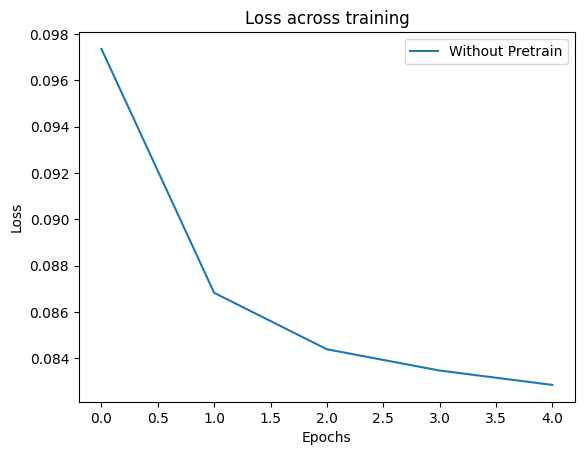

In [78]:
plt.plot(pretrain_results, label="Without Pretrain")
# plt.plot(pretrain_results['test_acc@1'], label="With Pretrain")
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Loss across training')
plt.legend()
plt.show()

## Visualizing pretraining results

model initialized with norm initialization


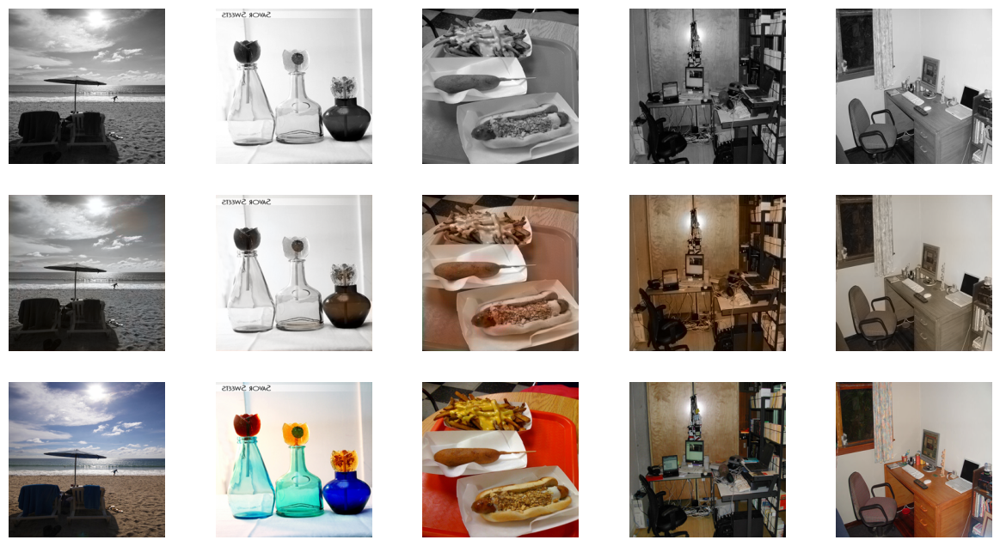

In [75]:
writer = SummaryWriter(log_dir='runs/experiment1')
net_G.load_state_dict(torch.load("res18-unet.pt", map_location=device))
model = MainModel(net_G=net_G)
visualize(model, data, writer, save=False)

## Training model

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=Inception_V3_Weights.IMAGENET1K_V1`. You can also use `weights=Inception_V3_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


model initialized with norm initialization


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


  0%|          | 0/500 [00:00<?, ?it/s]

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()



Epoch 1/15
Iteration 20/500
['loss_D_fake: 0.9026796698570252', 'loss_D_real: 0.913866662979126', 'loss_D: 0.9082731604576111', 'loss_G_GAN: 0.8954751461744308', 'loss_G_L1: 7.931516146659851', 'loss_G: 8.826991367340089']


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 28 pixels
  return func(*args, **kwargs)


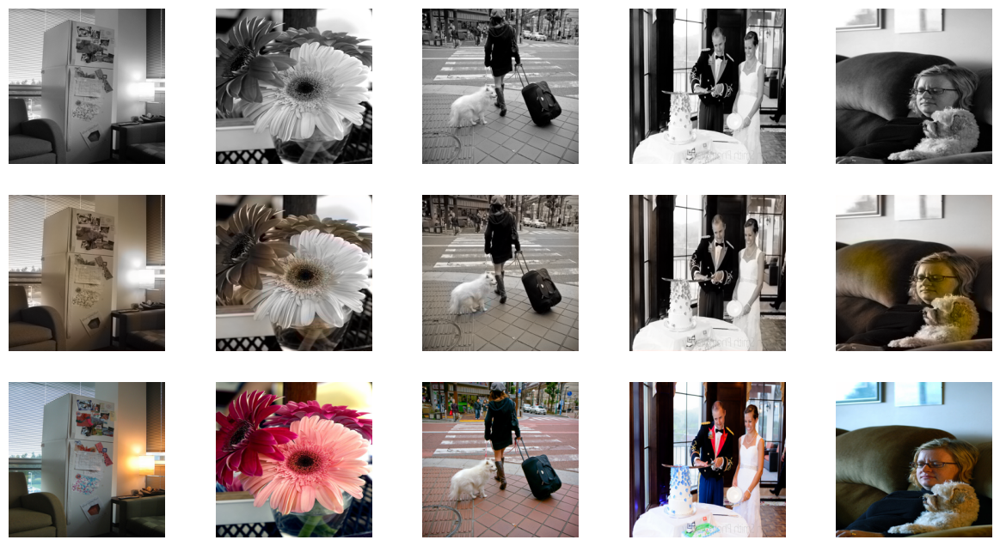

Best Model Saved

Epoch 1/15
Iteration 40/500
['loss_D_fake: 0.8099482953548431', 'loss_D_real: 0.8147004097700119', 'loss_D: 0.8123243510723114', 'loss_G_GAN: 0.8239372983574867', 'loss_G_L1: 8.169032633304596', 'loss_G: 8.99297000169754']


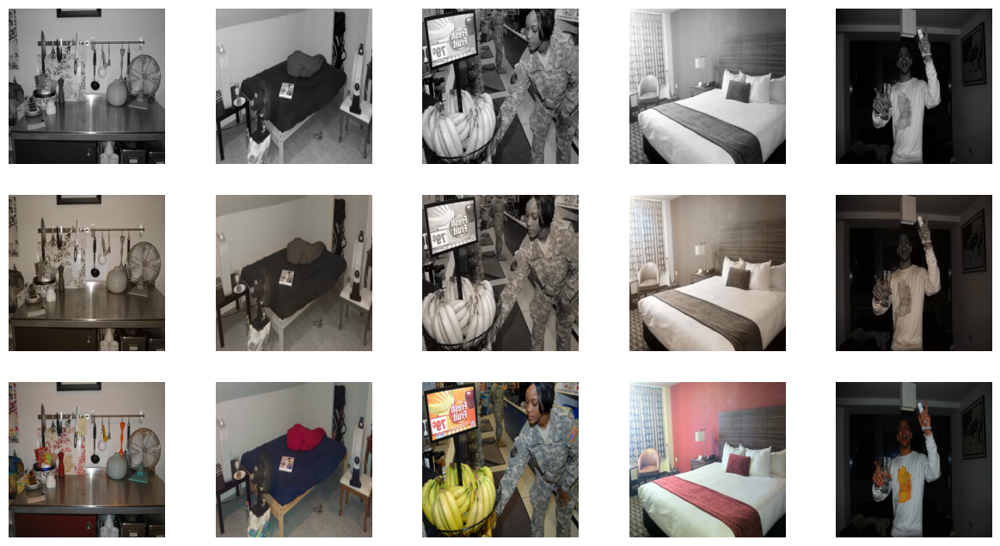


Epoch 1/15
Iteration 60/500
['loss_D_fake: 0.7675286809603373', 'loss_D_real: 0.775383323431015', 'loss_D: 0.7714560012022654', 'loss_G_GAN: 0.8103258242209752', 'loss_G_L1: 8.181636524200439', 'loss_G: 8.991962361335755']


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 17 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 12 pixels
  return func(*args, **kwargs)


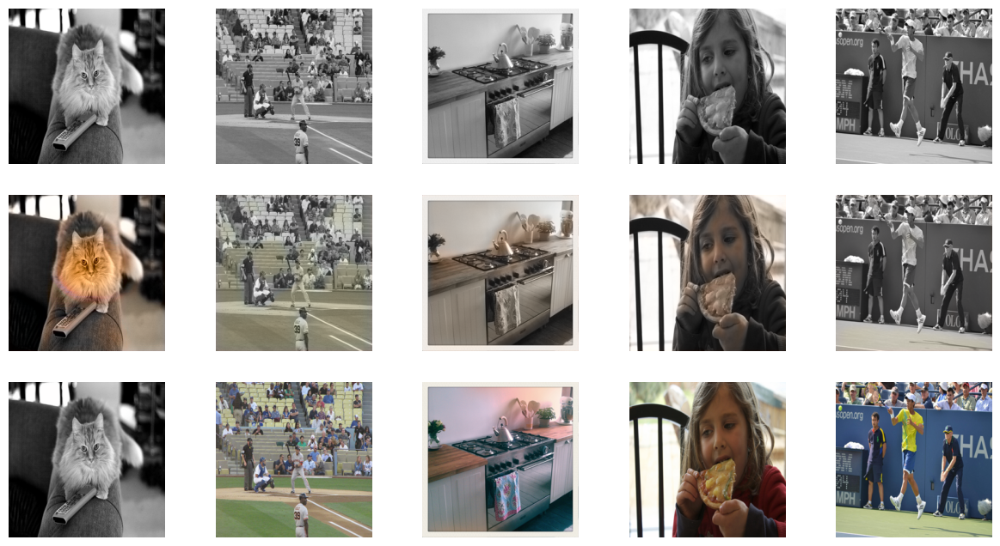


Epoch 1/15
Iteration 80/500
['loss_D_fake: 0.738284370303154', 'loss_D_real: 0.75070261657238', 'loss_D: 0.7444934949278832', 'loss_G_GAN: 0.8178580708801746', 'loss_G_L1: 8.265200102329255', 'loss_G: 9.083058172464371']


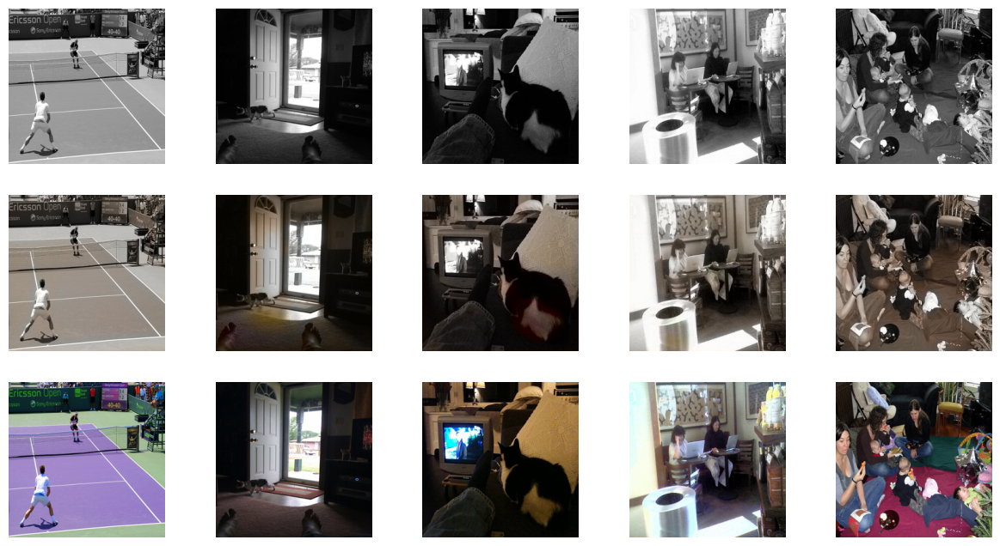


Epoch 1/15
Iteration 100/500
['loss_D_fake: 0.7136637568473816', 'loss_D_real: 0.725341351032257', 'loss_D: 0.7195025551319122', 'loss_G_GAN: 0.8293531256914138', 'loss_G_L1: 8.32579972743988', 'loss_G: 9.155152859687805']


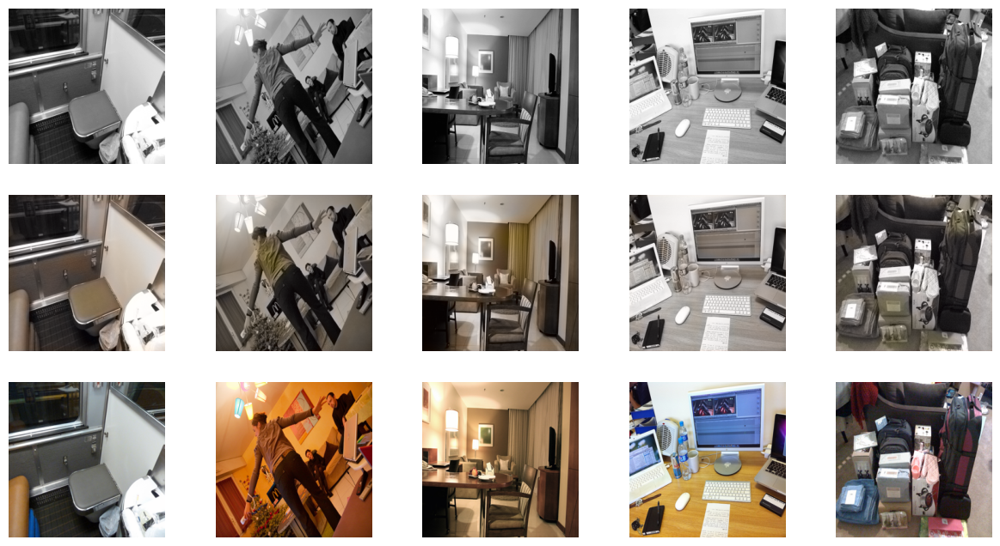


Epoch 1/15
Iteration 120/500
['loss_D_fake: 0.6978046814600627', 'loss_D_real: 0.7068058808644613', 'loss_D: 0.7023052821556727', 'loss_G_GAN: 0.8438174540797869', 'loss_G_L1: 8.427731510003408', 'loss_G: 9.271548970540364']


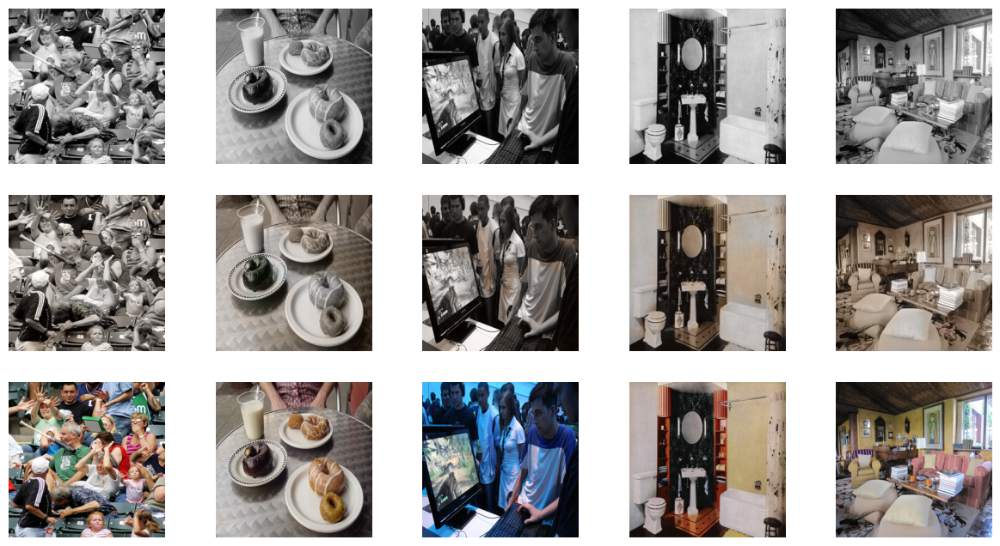


Epoch 1/15
Iteration 140/500
['loss_D_fake: 0.680632159113884', 'loss_D_real: 0.6891466076884951', 'loss_D: 0.6848893863814217', 'loss_G_GAN: 0.863163378408977', 'loss_G_L1: 8.425236504418509', 'loss_G: 9.288399893896921']


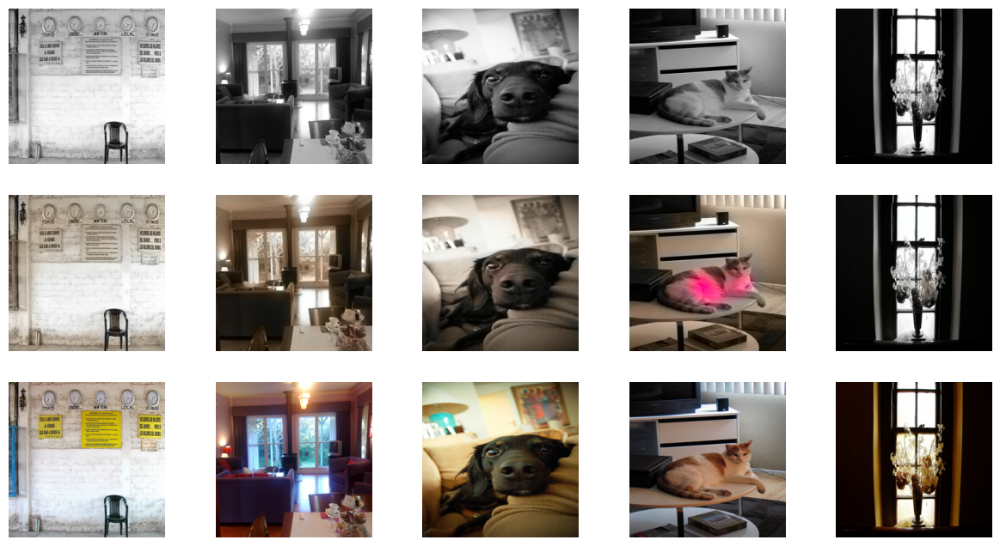


Epoch 1/15
Iteration 160/500
['loss_D_fake: 0.6675703756511211', 'loss_D_real: 0.6723328161984682', 'loss_D: 0.6699515983462334', 'loss_G_GAN: 0.8860303144901991', 'loss_G_L1: 8.431802445650101', 'loss_G: 9.317832770943642']


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 15 pixels
  return func(*args, **kwargs)


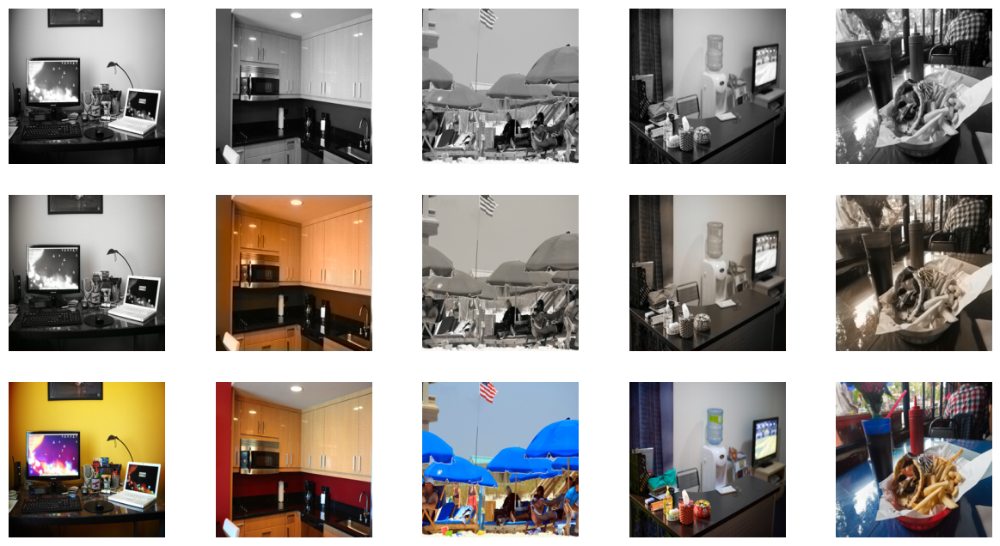


Epoch 1/15
Iteration 180/500
['loss_D_fake: 0.6531886812713411', 'loss_D_real: 0.6639080017805099', 'loss_D: 0.6585483431816102', 'loss_G_GAN: 0.897509288125568', 'loss_G_L1: 8.442696221669515', 'loss_G: 9.340205507808262']


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 417 pixels
  return func(*args, **kwargs)


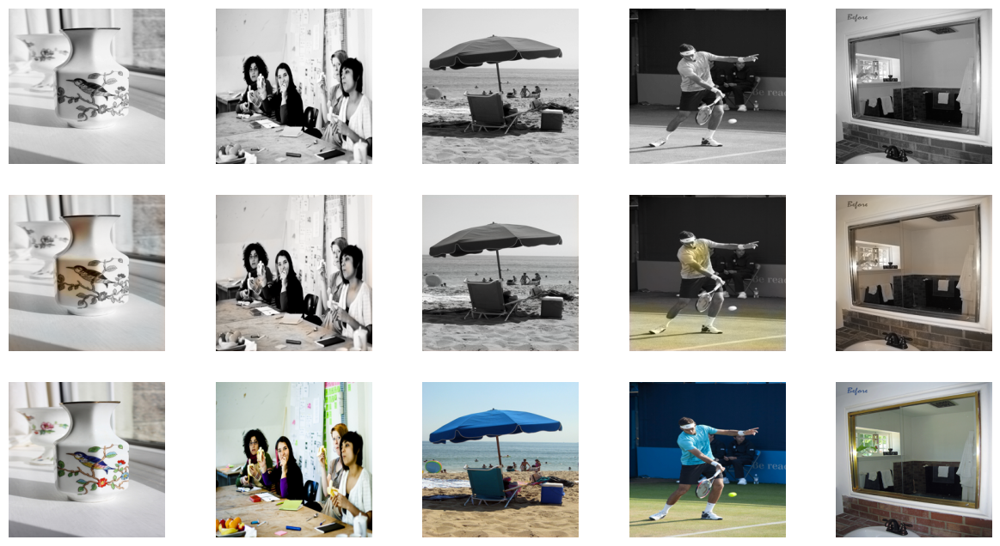


Epoch 1/15
Iteration 200/500
['loss_D_fake: 0.6487263464927673', 'loss_D_real: 0.6562591308355331', 'loss_D: 0.6524927401542664', 'loss_G_GAN: 0.9131755736470223', 'loss_G_L1: 8.433608212471007', 'loss_G: 9.346783781051636']


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 337 pixels
  return func(*args, **kwargs)


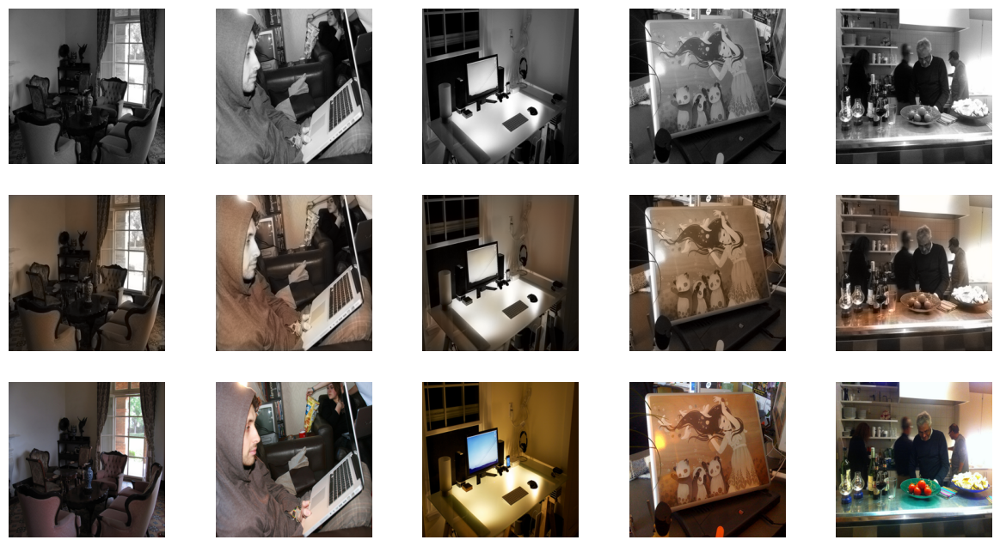


Epoch 1/15
Iteration 220/500
['loss_D_fake: 0.6410064675591208', 'loss_D_real: 0.646344858137044', 'loss_D: 0.6436756643381986', 'loss_G_GAN: 0.927540755813772', 'loss_G_L1: 8.420642371611162', 'loss_G: 9.348183116045865']


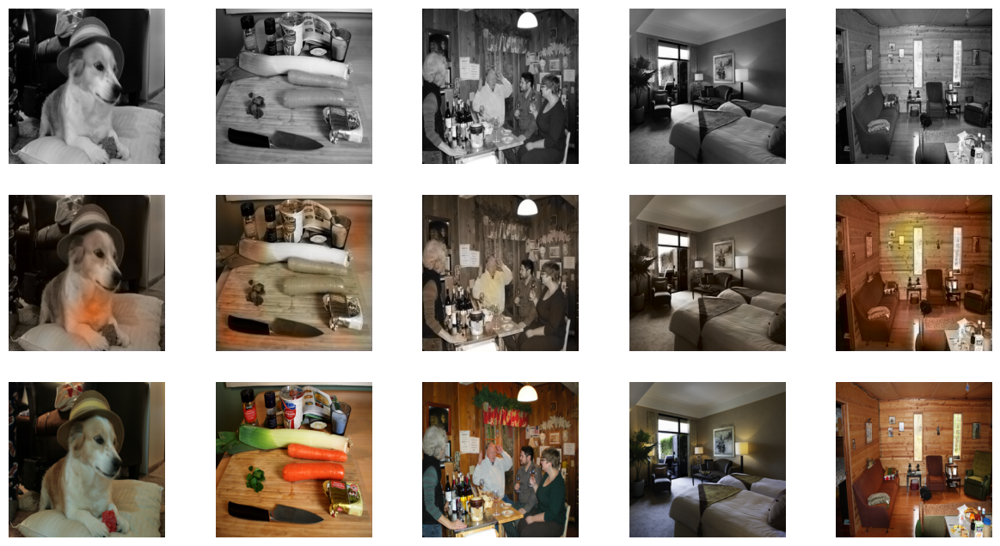


Epoch 1/15
Iteration 240/500
['loss_D_fake: 0.6366048773129781', 'loss_D_real: 0.6380189076066017', 'loss_D: 0.6373118941982587', 'loss_G_GAN: 0.9400431593259175', 'loss_G_L1: 8.450155584017436', 'loss_G: 9.390198727448782']


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 1934 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 89 pixels
  return func(*args, **kwargs)


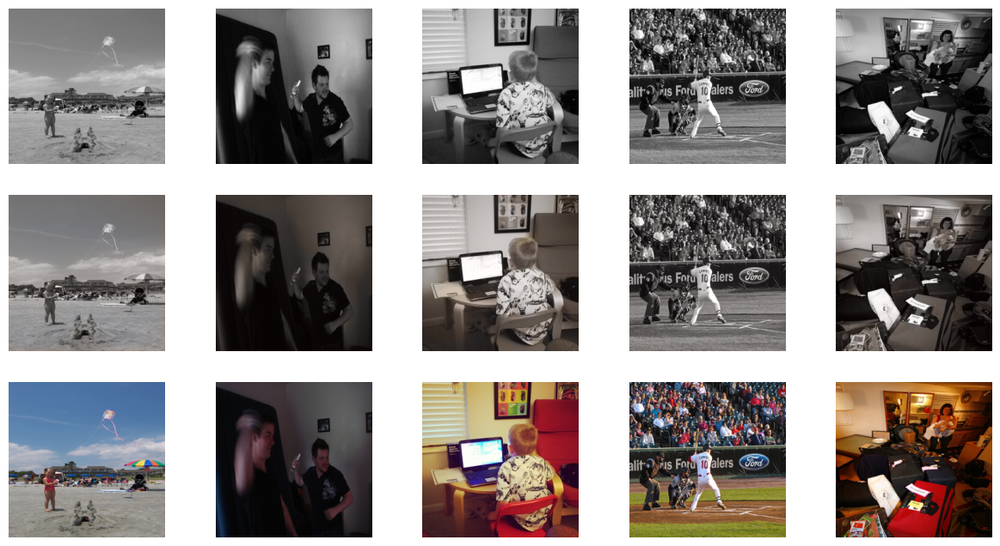


Epoch 1/15
Iteration 260/500
['loss_D_fake: 0.6254254682705953', 'loss_D_real: 0.6288624857480709', 'loss_D: 0.6271439783848249', 'loss_G_GAN: 0.9671800141151135', 'loss_G_L1: 8.47684921851525', 'loss_G: 9.444029215665964']


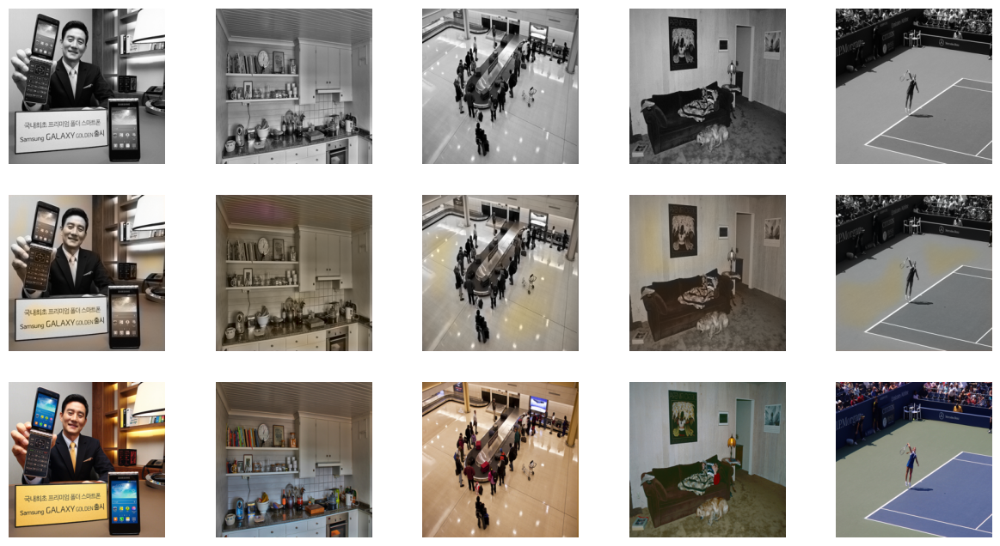


Epoch 1/15
Iteration 280/500
['loss_D_fake: 0.6141270907861845', 'loss_D_real: 0.6169377571770123', 'loss_D: 0.6155324256845883', 'loss_G_GAN: 0.9829687378236226', 'loss_G_L1: 8.503185760974883', 'loss_G: 9.486154483045851']


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 12 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 3 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 606 pixels
  return func(*args, **kwargs)


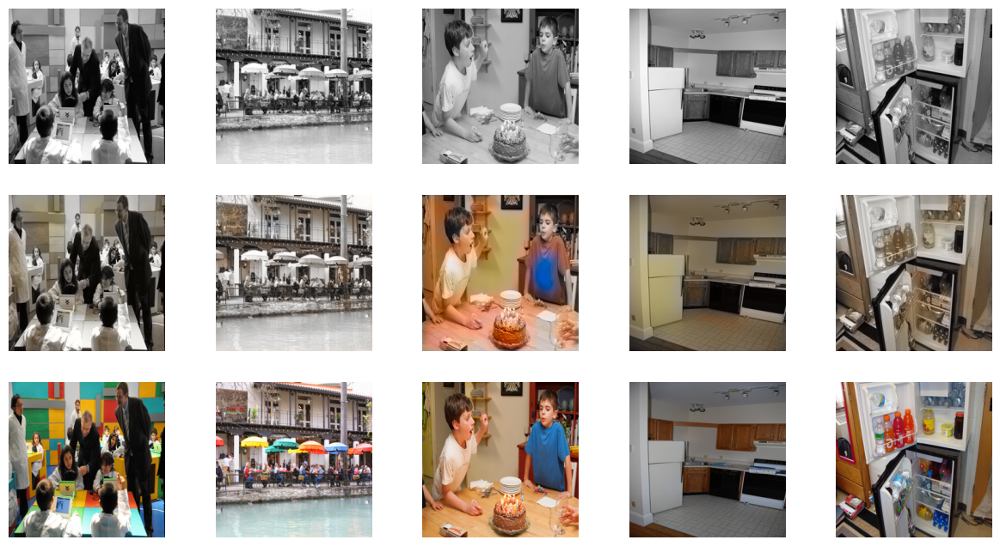


Epoch 1/15
Iteration 300/500
['loss_D_fake: 0.6155926072597504', 'loss_D_real: 0.6172423583269119', 'loss_D: 0.6164174844821294', 'loss_G_GAN: 0.9942186929782232', 'loss_G_L1: 8.525482269922891', 'loss_G: 9.519700951576233']


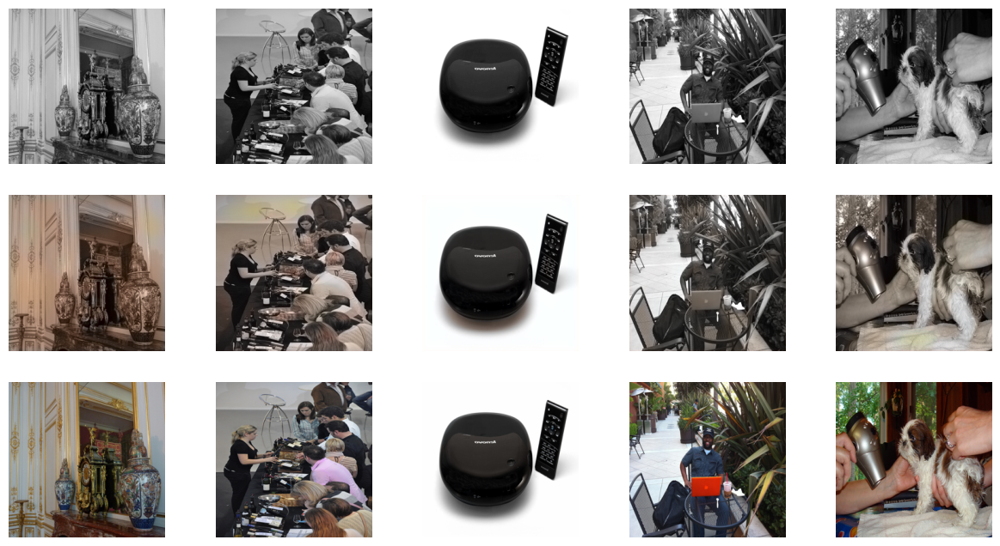


Epoch 1/15
Iteration 320/500
['loss_D_fake: 0.6076199119910598', 'loss_D_real: 0.6087830821052194', 'loss_D: 0.6082014989107847', 'loss_G_GAN: 1.009405325166881', 'loss_G_L1: 8.532290035486222', 'loss_G: 9.541695348918438']


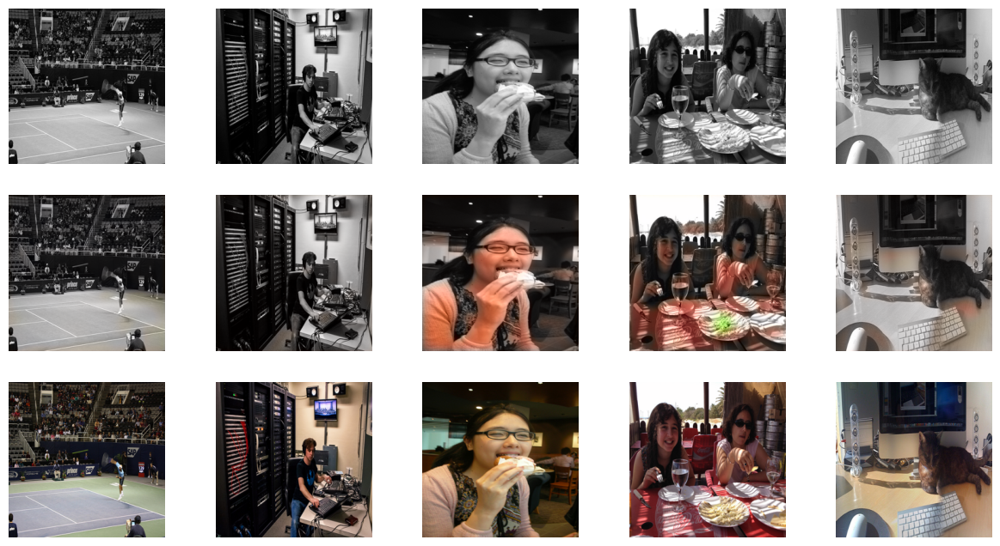


Epoch 1/15
Iteration 340/500
['loss_D_fake: 0.600411967056639', 'loss_D_real: 0.6003387461690342', 'loss_D: 0.6003753583220874', 'loss_G_GAN: 1.0295870965017992', 'loss_G_L1: 8.564432588745566', 'loss_G: 9.594019678059746']


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 59 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 29 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 118 pixels
  return func(*args, **kwargs)


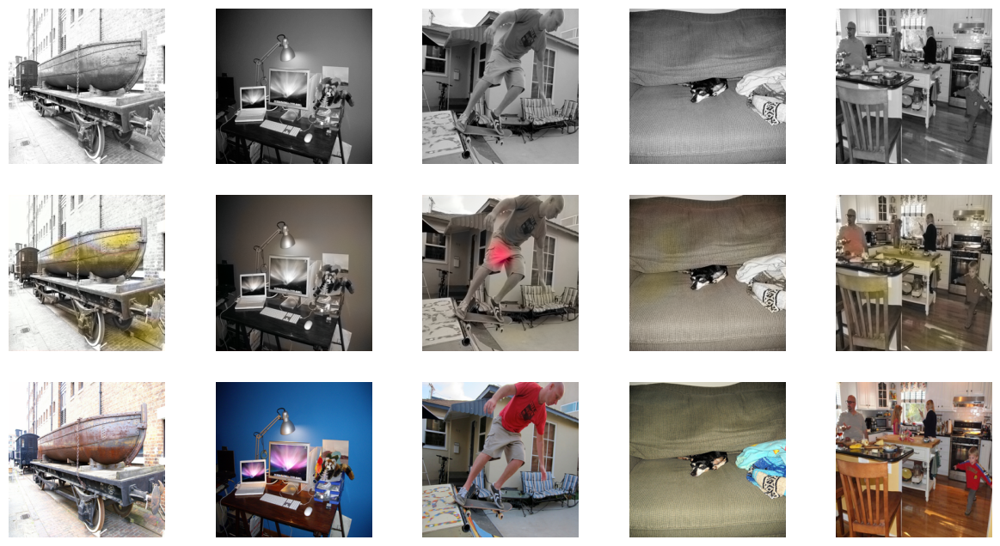


Epoch 1/15
Iteration 360/500
['loss_D_fake: 0.5944578189816739', 'loss_D_real: 0.5921808517641491', 'loss_D: 0.5933193369044198', 'loss_G_GAN: 1.0453290515475804', 'loss_G_L1: 8.60759394036399', 'loss_G: 9.65292298131519']


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 4 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 7 pixels
  return func(*args, **kwargs)


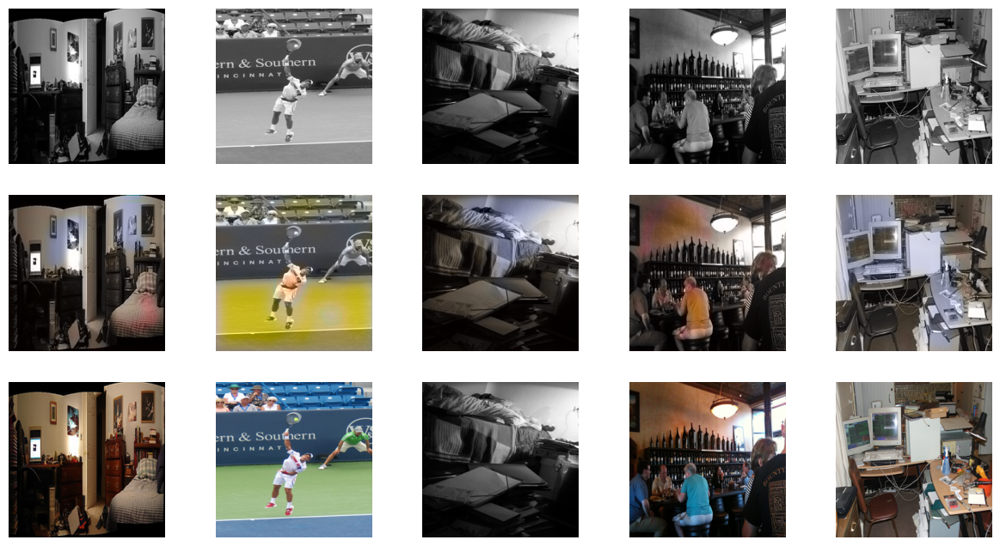


Epoch 1/15
Iteration 380/500
['loss_D_fake: 0.5947783857583999', 'loss_D_real: 0.5906500519890534', 'loss_D: 0.5927142202854156', 'loss_G_GAN: 1.059357447059531', 'loss_G_L1: 8.646714293329339', 'loss_G: 9.706071728154233']


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 12 pixels
  return func(*args, **kwargs)


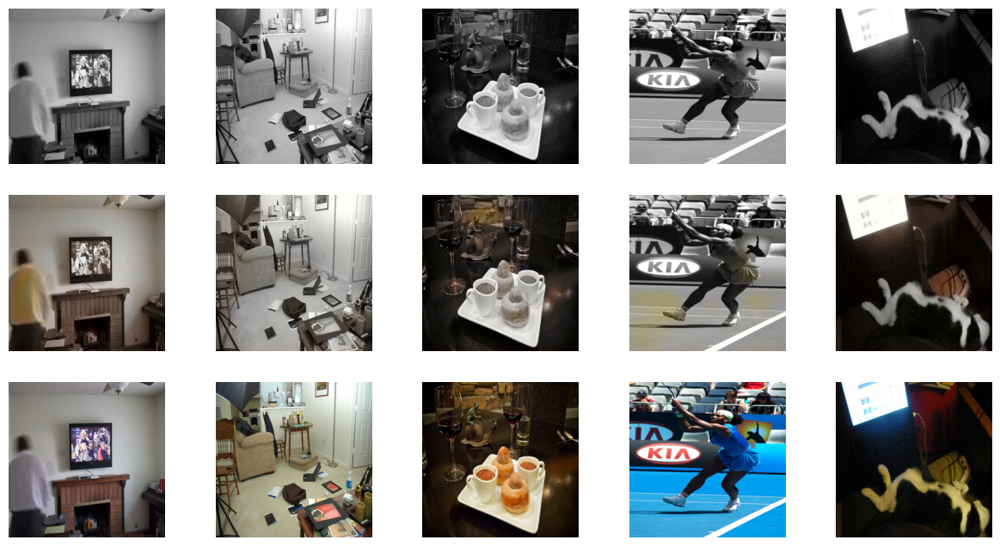


Epoch 1/15
Iteration 400/500
['loss_D_fake: 0.5900671458244324', 'loss_D_real: 0.5868779779970645', 'loss_D: 0.5884725633263588', 'loss_G_GAN: 1.069317319393158', 'loss_G_L1: 8.659103858470917', 'loss_G: 9.72842116355896']


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 35 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 383 pixels
  return func(*args, **kwargs)


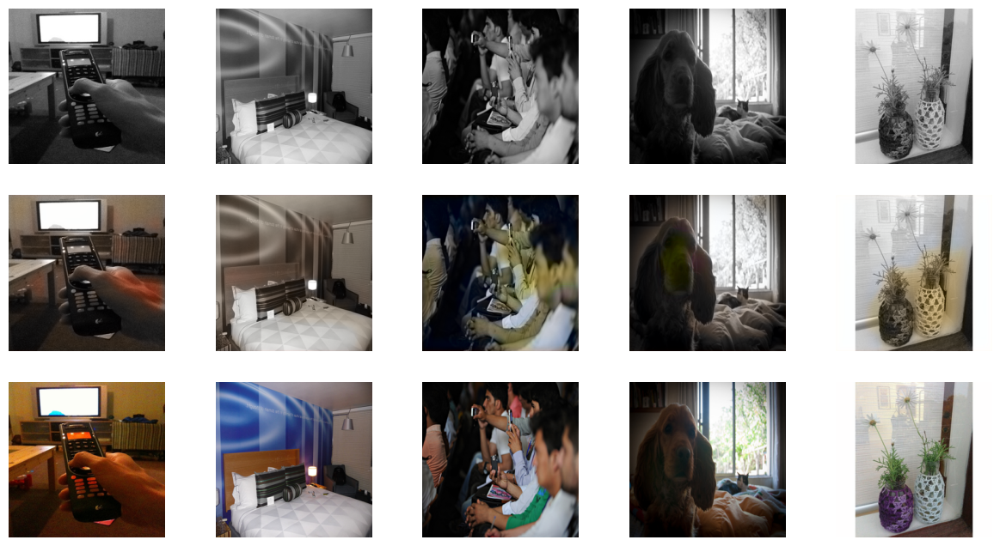


Epoch 1/15
Iteration 420/500
['loss_D_fake: 0.5866720154171898', 'loss_D_real: 0.5839157081785656', 'loss_D: 0.5852938632170359', 'loss_G_GAN: 1.0776888736656733', 'loss_G_L1: 8.700472199349177', 'loss_G: 9.778161062513078']


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 10 pixels
  return func(*args, **kwargs)


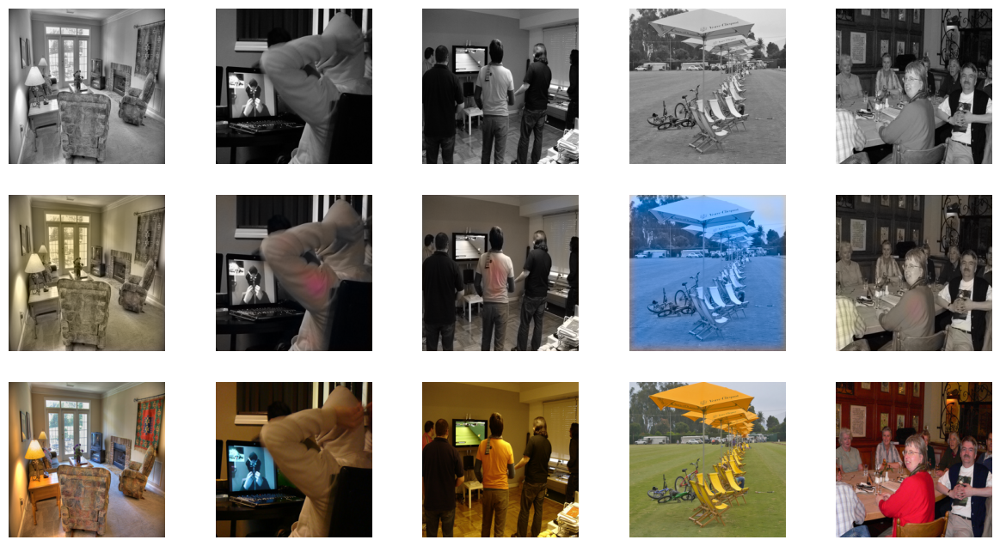


Epoch 1/15
Iteration 440/500
['loss_D_fake: 0.583889192816886', 'loss_D_real: 0.5816334898498925', 'loss_D: 0.5827613429589705', 'loss_G_GAN: 1.090479253097014', 'loss_G_L1: 8.746331201900135', 'loss_G: 9.836810450120407']


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 14 pixels
  return func(*args, **kwargs)


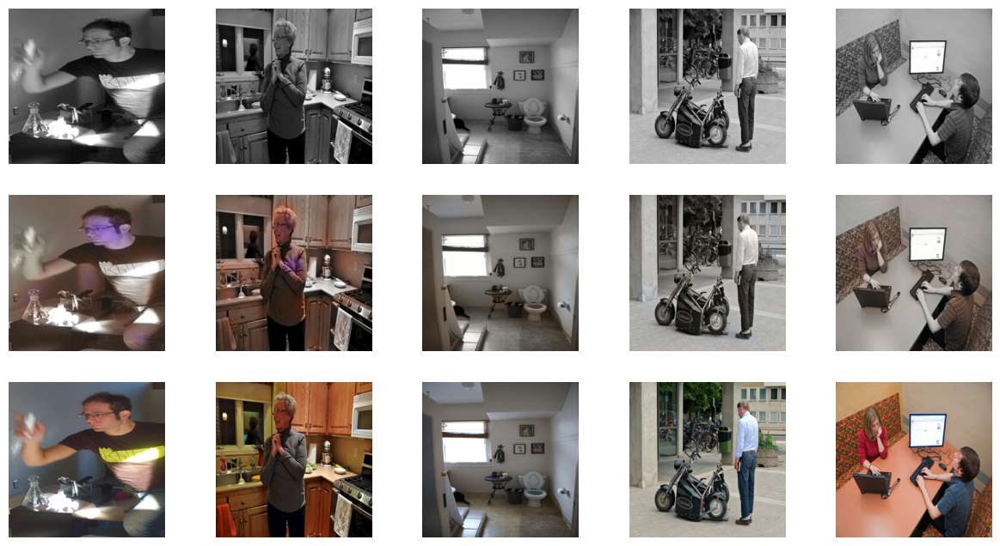


Epoch 1/15
Iteration 460/500
['loss_D_fake: 0.5815680704686953', 'loss_D_real: 0.5782841147935909', 'loss_D: 0.5799260940240777', 'loss_G_GAN: 1.099627746835999', 'loss_G_L1: 8.77096645521081', 'loss_G: 9.870594202953836']


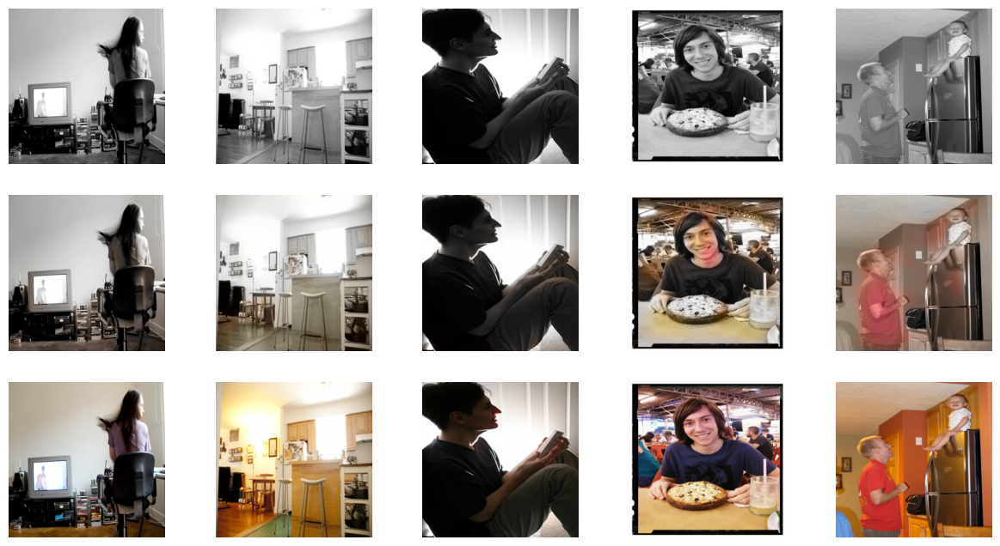


Epoch 1/15
Iteration 480/500
['loss_D_fake: 0.5778735567505161', 'loss_D_real: 0.5770744148020943', 'loss_D: 0.5774739872664213', 'loss_G_GAN: 1.1107722027848164', 'loss_G_L1: 8.787646064162255', 'loss_G: 9.89841826359431']


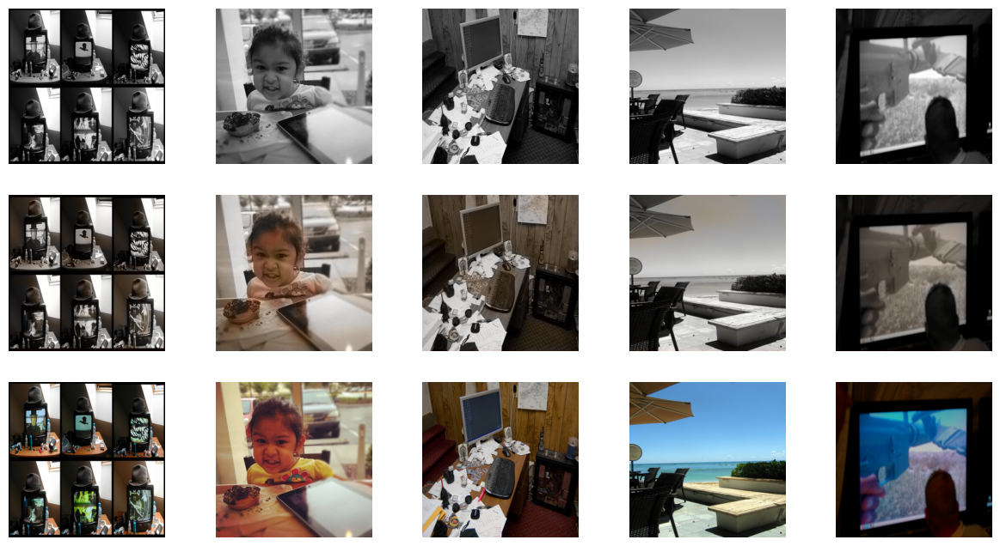


Epoch 1/15
Iteration 500/500
['loss_D_fake: 0.5740359873771668', 'loss_D_real: 0.5722412765026093', 'loss_D: 0.5731386332511902', 'loss_G_GAN: 1.1163566493988037', 'loss_G_L1: 8.79821748161316', 'loss_G: 9.914574123382568']


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 51 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 7 pixels
  return func(*args, **kwargs)


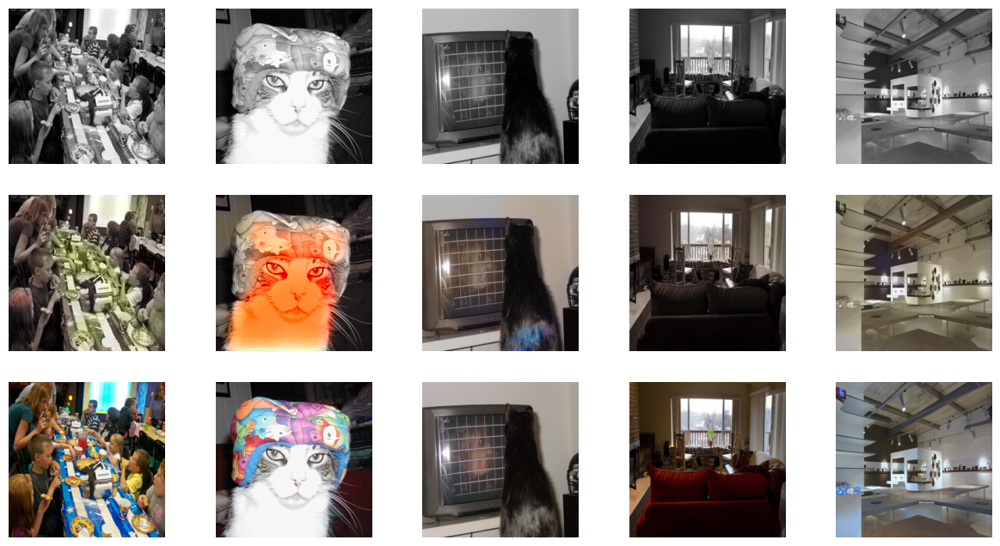

  0%|          | 0/500 [00:00<?, ?it/s]

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()



Epoch 2/15
Iteration 20/500
['loss_D_fake: 0.6746621519327164', 'loss_D_real: 0.6384739950299263', 'loss_D: 0.6565680801868439', 'loss_G_GAN: 1.0744222670793533', 'loss_G_L1: 8.76807279586792', 'loss_G: 9.842495036125182']


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 107 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 1889 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 8 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 70 pixels
  return func(*args, **kwargs)


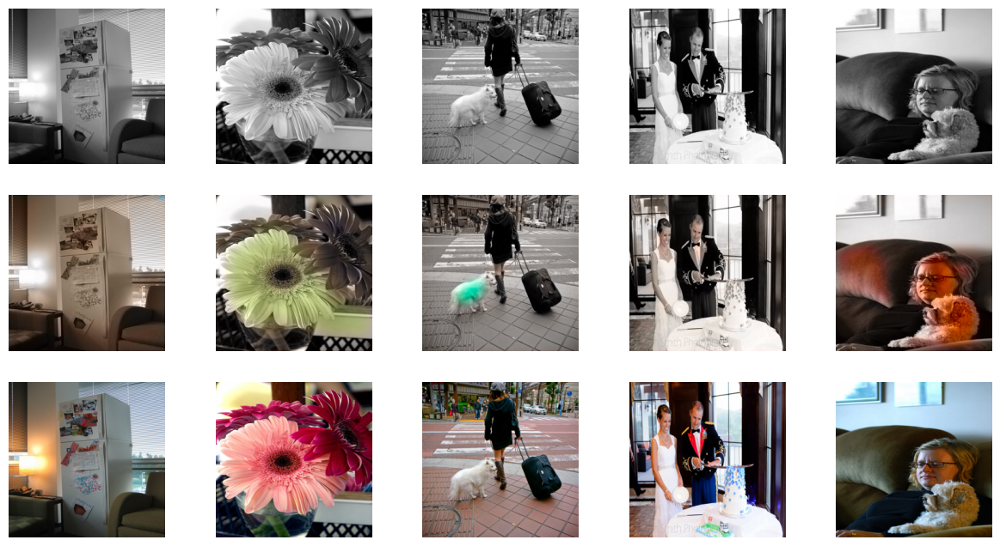

In [ ]:
def train_model(model, train_dl, epochs, display_every=20):
    data = next(iter(val_dl)) # getting a batch for visualizing the model output after fixed intrvals
    best_model = None
    best_loss = float('inf')
    for e in range(epochs):
        loss_meter_dict = create_loss_meters() # function returing a dictionary of objects to
        i = 0                                  # log the losses of the complete network
        for data in tqdm(train_dl):
            model.setup_input(data)
            model.optimize(i)
            update_losses(model, loss_meter_dict, count=data['L'].size(0)) # function updating the log objects
            # print([f"{loss_name}: {loss_meter.avg}" for loss_name, loss_meter in loss_meter_dict.items()])
            #print('loss_D_fake': loss_D_fake, loss_D_real': loss_D_real, 'loss_D': loss_D)
            #print('loss_G_GAN': loss_G_GAN, 'loss_G_L1': loss_G_L1, 'loss_G': loss_G)
            i += 1
            if i % display_every == 0:
                print(f"\nEpoch {e+1}/{epochs}")
                print(f"Iteration {i}/{len(train_dl)}")
                #log_results(loss_meter_dict) # function to print out the losses
                print([f"{loss_name}: {loss_meter.avg}" for loss_name, loss_meter in loss_meter_dict.items()])
                # print('loss_D_fake': loss_D_fake, loss_D_real': loss_D_real, 'loss_D': loss_D)
                visualize(model, data, writer, global_step=0, save=False) # function displaying the model's outputs

                if best_loss > loss_meter_dict['loss_G'].avg:
                  best_loss = loss_meter_dict['loss_G'].avg
                  best_model = model
                  torch.save(best_model.state_dict(), "best_model2.pt")
                  print("Best Model Saved")

## With pretraining?
pretraining = True

## inception
import torchvision.models as models
inception = models.inception_v3(pretrained=True)
inception_coco = models.segmentation.deeplabv3_resnet50(weights = 'DeepLabV3_ResNet50_Weights.COCO_WITH_VOC_LABELS_V1')

writer = SummaryWriter(log_dir='runs/experiment1')
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

if pretraining:
  net_G.load_state_dict(torch.load("res18-unet.pt", map_location=device))
  model = model.to(device)
  model = MainModel(net_G=net_G)
  train_model(model, train_dl, 15)
else:
  model = MainModel()
  #model = model.to(device)
  train_model(model, train_dl, 15) # 100
  torch.save(model.state_dict(), "final_model_weights.pt")